Image to OBJ Conversion

In [5]:
!pip install numpy matplotlib opencv-python pillow trimesh pythreejs scikit-image


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 703.2/703.2 kB 28.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 63.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 271.7/271.7 kB 21.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 54.0 MB/s eta 0:00:00


Saving generated_tile_955.png to generated_tile_955 (1).png


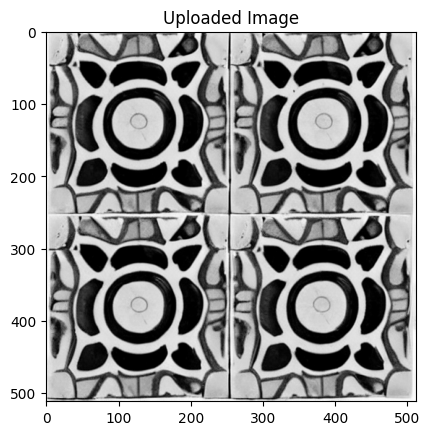

In [6]:

from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files

# Upload image file (or use preloaded file path from your environment)
uploaded = files.upload()

# Load the image
img_path = list(uploaded.keys())[0]  # First uploaded image
image = Image.open(img_path)


img = image.convert('L')  # Convert to grayscale for simplicity

# Convert the image to a numpy array for processing
img_array = np.array(img)

# Display the image
plt.imshow(img_array, cmap='gray')
plt.title("Uploaded Image")
plt.show()


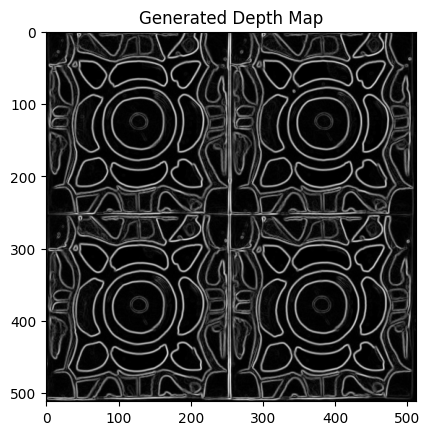

In [7]:
from skimage import filters

# Edge detection or intensity gradient for depth simulation
depth_map = filters.sobel(img_array)

# Display the depth map
plt.imshow(depth_map, cmap='gray')
plt.title("Generated Depth Map")
plt.show()


In [15]:
import trimesh

# Parameters
height, width = img_array.shape
tile_height = 0.2  # Set a fixed height for the tile

# Create a grid of coordinates for the 3D mesh (X, Y, Z)
x = np.linspace(0, 1, width)
y = np.linspace(0, 1, height)
x, y = np.meshgrid(x, y)

# Use the depth map for the Z coordinate (height)
z = depth_map / np.max(depth_map) * tile_height  # Scale depth to tile height

# Flatten the arrays for trimesh
vertices = np.vstack((x.flatten(), y.flatten(), z.flatten())).T

# Create faces (triangles) for the mesh grid
faces = []
for i in range(height - 1):
    for j in range(width - 1):
        faces.append([i * width + j, i * width + (j + 1), (i + 1) * width + j])
        faces.append([(i + 1) * width + j, i * width + (j + 1), (i + 1) * width + (j + 1)])

faces = np.array(faces)

# Create the mesh object
mesh = trimesh.Trimesh(vertices=vertices, faces=faces)

# Export the mesh as an OBJ file
mesh.export('tile.obj')


'# https://github.com/mikedh/trimesh\nv 0.00000000 0.00000000 0.00627341\nv 0.00195695 0.00000000 0.00498514\nv 0.00391389 0.00000000 0.00122616\nv 0.00587084 0.00000000 0.00601431\nv 0.00782779 0.00000000 0.01675962\nv 0.00978474 0.00000000 0.01464468\nv 0.01174168 0.00000000 0.00255823\nv 0.01369863 0.00000000 0.00339075\nv 0.01565558 0.00000000 0.00470212\nv 0.01761252 0.00000000 0.00520217\nv 0.01956947 0.00000000 0.00462628\nv 0.02152642 0.00000000 0.00492265\nv 0.02348337 0.00000000 0.00595520\nv 0.02544031 0.00000000 0.00627341\nv 0.02739726 0.00000000 0.00487753\nv 0.02935421 0.00000000 0.00479524\nv 0.03131115 0.00000000 0.00346811\nv 0.03326810 0.00000000 0.00180894\nv 0.03522505 0.00000000 0.00122616\nv 0.03718200 0.00000000 0.00346811\nv 0.03913894 0.00000000 0.00358103\nv 0.04109589 0.00000000 0.00066498\nv 0.04305284 0.00000000 0.00380843\nv 0.04500978 0.00000000 0.00292894\nv 0.04696673 0.00000000 0.00442100\nv 0.04892368 0.00000000 0.00548357\nv 0.05088063 0.00000000 0.

In [ ]:
from google.colab import files
files.download('tile.obj')

Here, obj file has one side and the other side is messedup. Now, Adding up flat side at the back of tile.